In [1]:
import os
import sys
import inspect

currentdir = os.path.dirname(os.path.abspath(inspect.getfile(inspect.currentframe())))
parentdir = os.path.dirname(currentdir)
sys.path.insert(0, parentdir) 

In [2]:
import warnings
warnings.filterwarnings('ignore')
from tqdm.notebook import tqdm
import pandas as pd
from load_dataset import TimeSeries
import numpy as np
from annot_finder import annot_finder

In [3]:
# Import methods
from cpfinder.methods import bocpd, rulsif

# Vis
from vis import plot_matplotlib
import matplotlib.pyplot as plt

# Import evaluation metrics
import cpfinder.eval_metrics as EVM
from cpfinder.feature_engineering import _get_cps_from_R


# Dataset folder 
DATA_PATH = "../../Light data/TCPD/datasets"

In [4]:
#  List all the dataset names
import pathlib
import json 

datasets = list(pathlib.Path(DATA_PATH).glob('*'))
annots_file = list(pathlib.Path(os.path.dirname(pathlib.Path(DATA_PATH))).glob('annot*.json'))[0]
print(datasets[:3],len(datasets))

[PosixPath('../../Light data/TCPD/datasets/apple'), PosixPath('../../Light data/TCPD/datasets/bee_waggle_6'), PosixPath('../../Light data/TCPD/datasets/shanghai_license')] 43


In [5]:
# Find all json files in folders
data_files = []
for data_folder in datasets:
    data_files.extend(list(data_folder.glob("*.json")))

100%|██████████| 622/622 [00:01<00:00, 418.72it/s]

apple -----> f1 = 0.45783132530120485, covering = 0.7264862631045028 
  ---------- TOTAL: f1_mean = 0.45783132530120485, covering_mean = 0.7264862631045028
100%|██████████| 622/622 [00:01<00:00, 474.14it/s]

apple -----> f1 = 0.0379746835443038, covering = 0.05659163987138264 
  ---------- TOTAL: f1_mean = 0.24790300442275431, covering_mean = 0.3915389514879427
100%|██████████| 609/609 [00:01<00:00, 391.19it/s]

bee_waggle_6 -----> f1 = 0.48148148148148145, covering = 0.7178453081807395 
  ---------- TOTAL: f1_mean = 0.3257624967756634, covering_mean = 0.5003077370522083
  0%|          | 0/609 [00:00<?, ?it/s]
bee_waggle_6 -----> f1 = 0.24528301886792453, covering = 0.45310292699455257 
  ---------- TOTAL: f1_mean = 0.30564262729872865, covering_mean = 0.48850653453779436
  0%|          | 0/609 [00:00<?, ?it/s]
bee_waggle_6 -----> f1 = 0.9285714285714287, covering = 0.8911284212456287 
  ---------- TOTAL: f1_mean = 0.43022838755326864

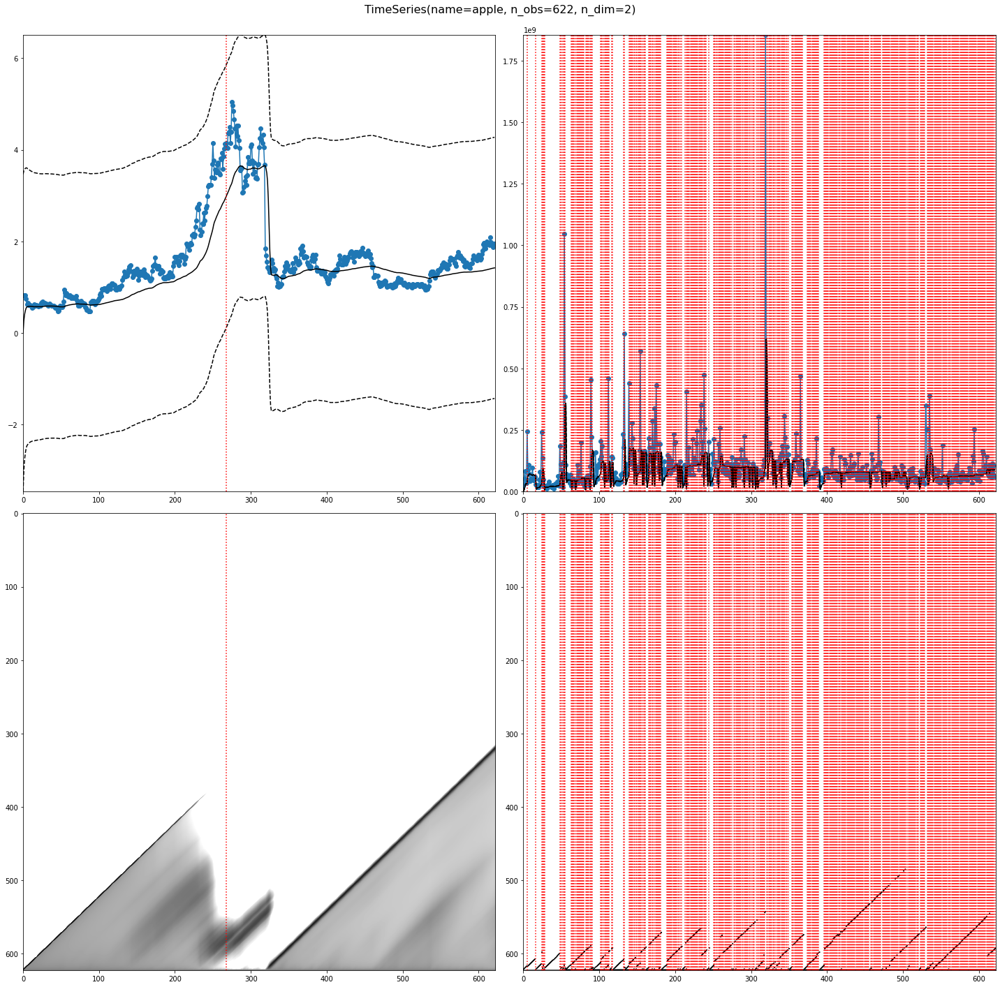

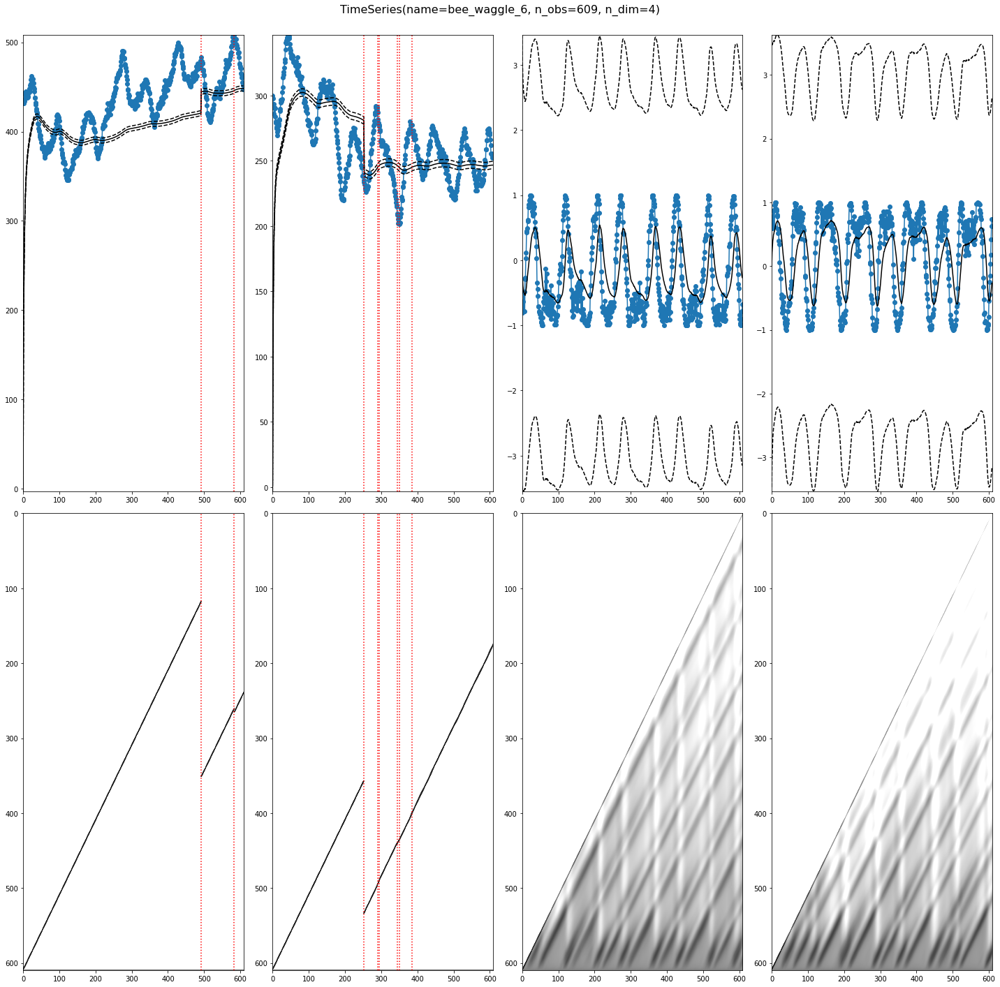

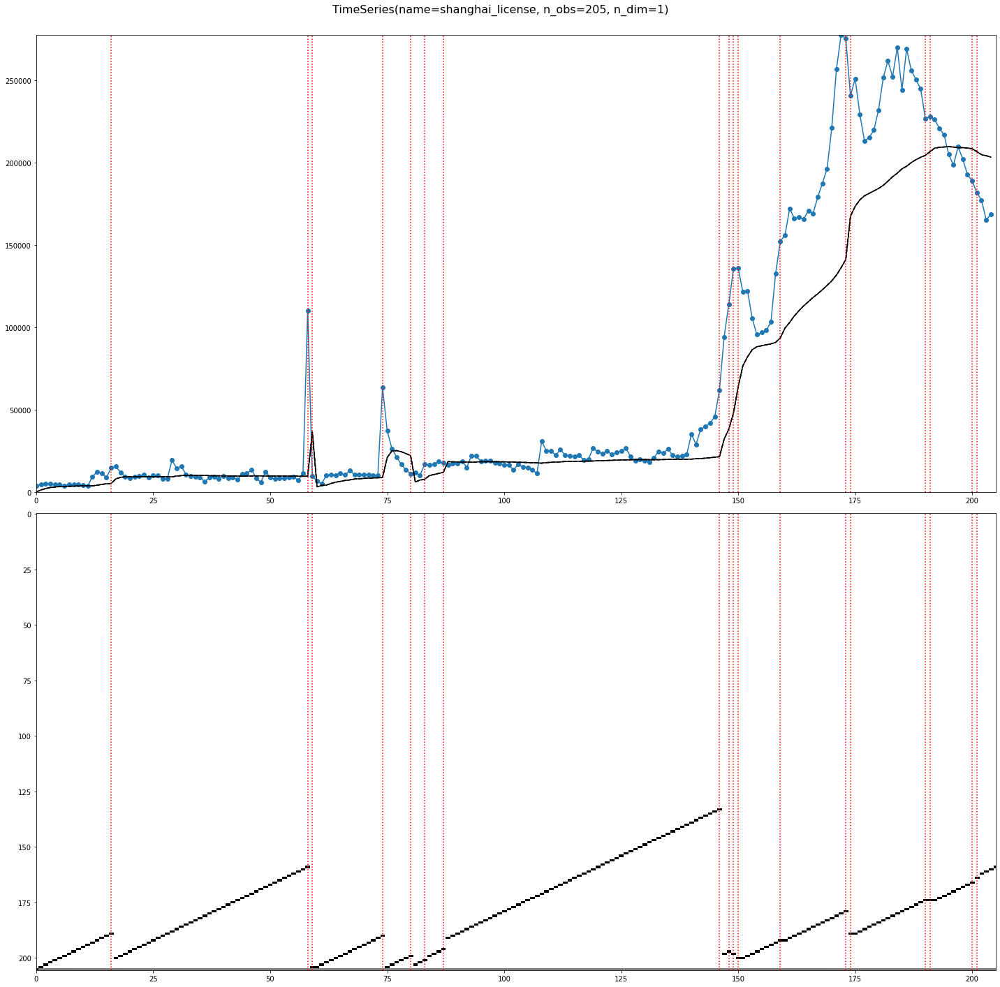

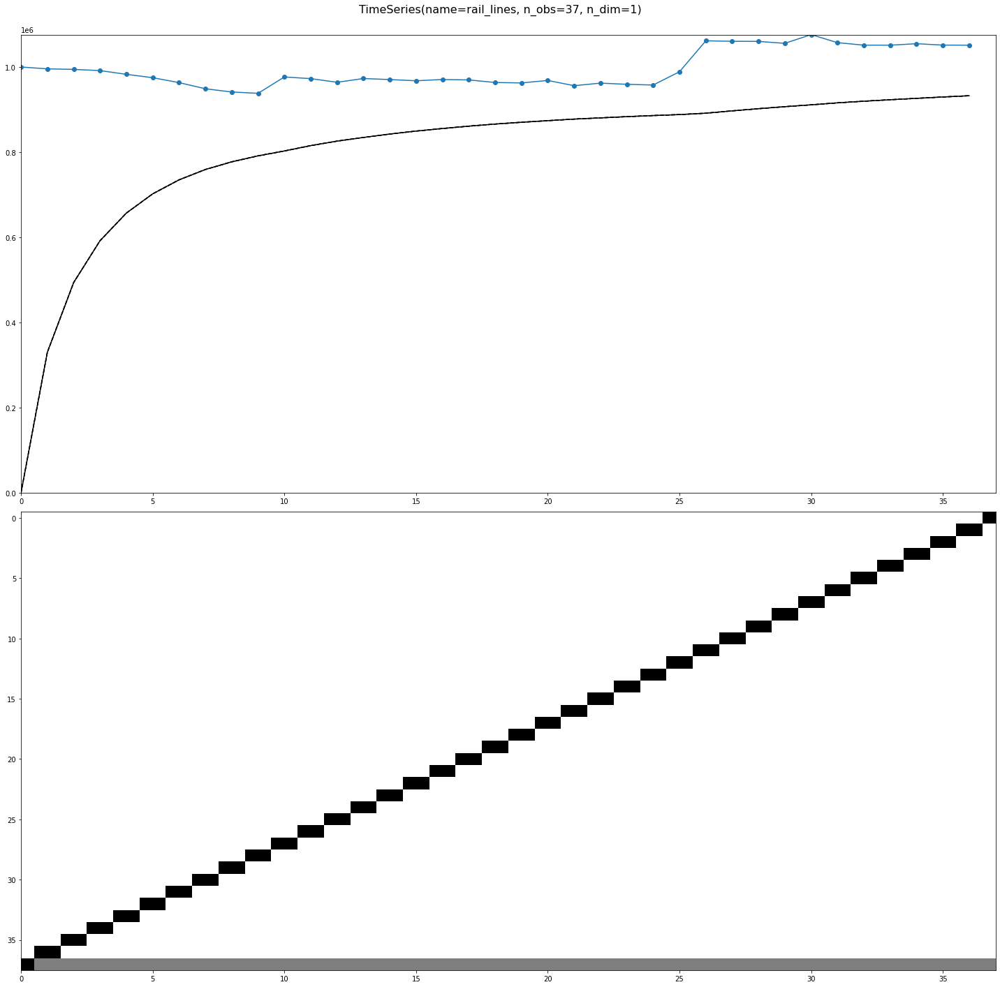

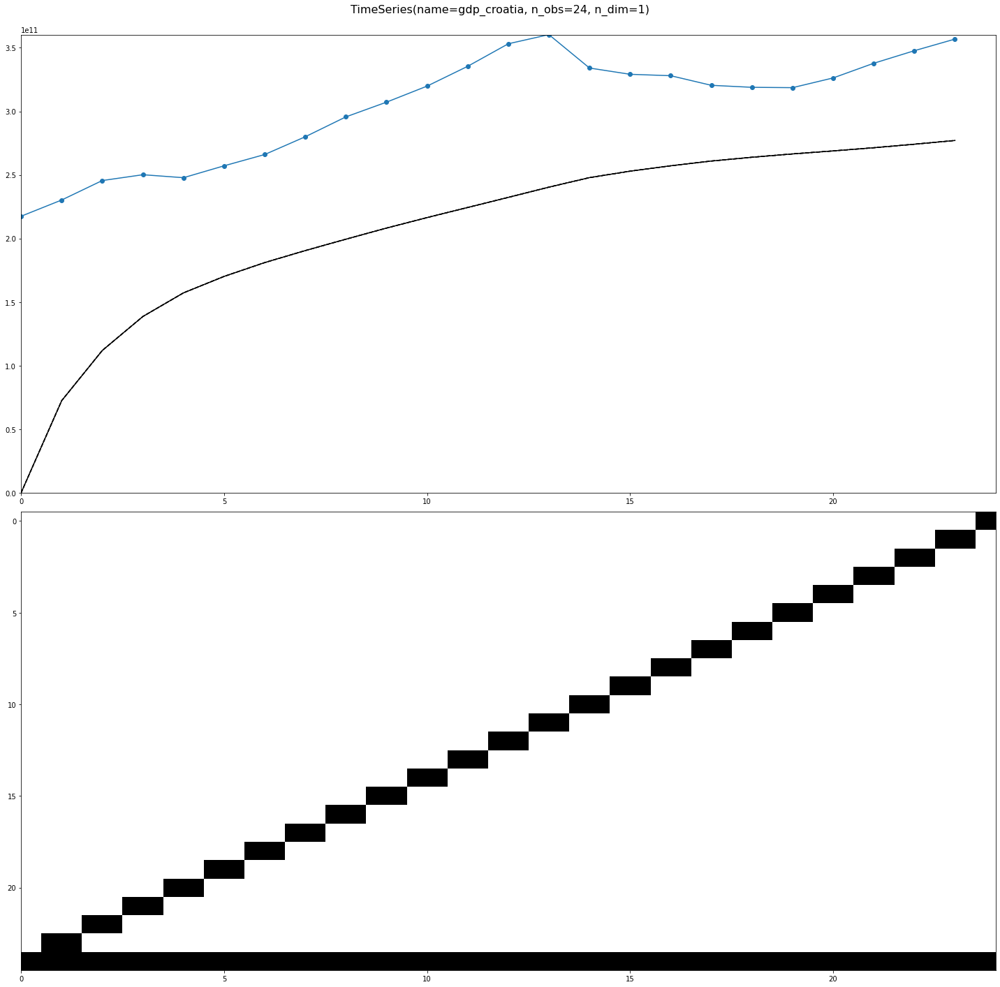

...

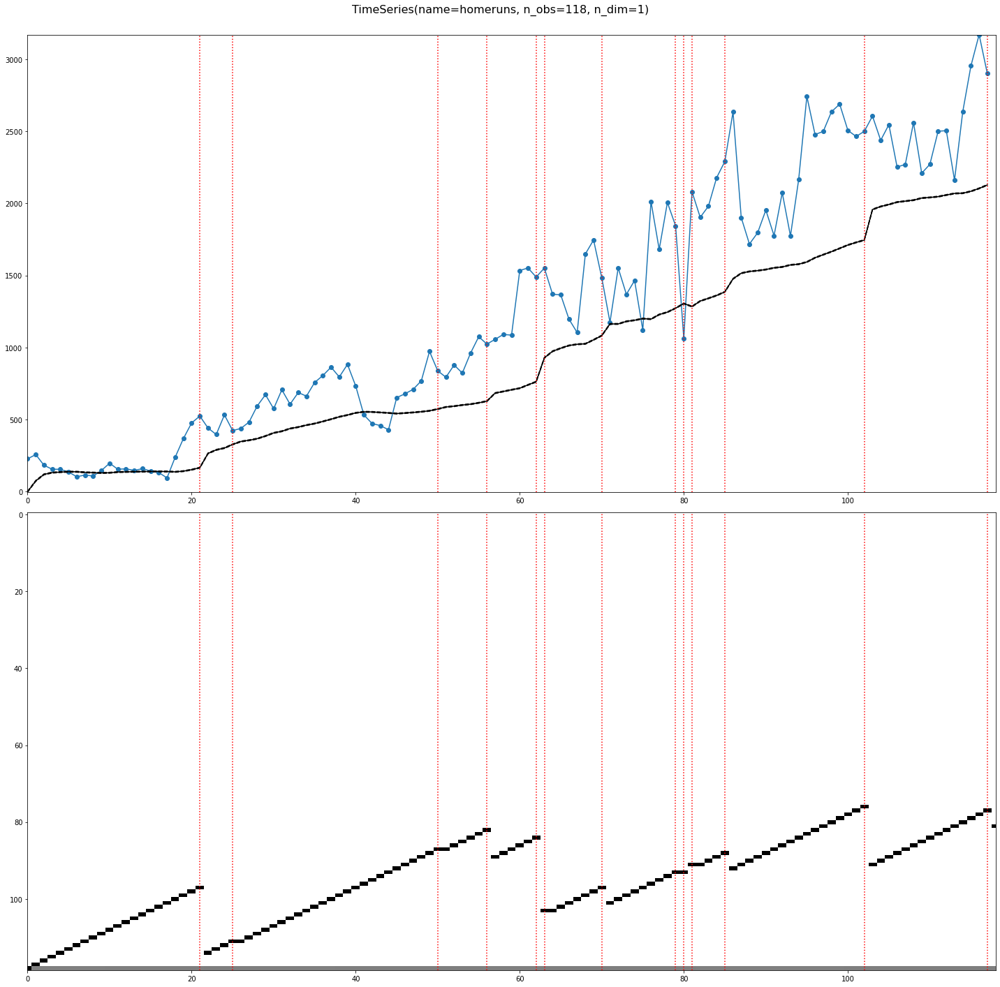

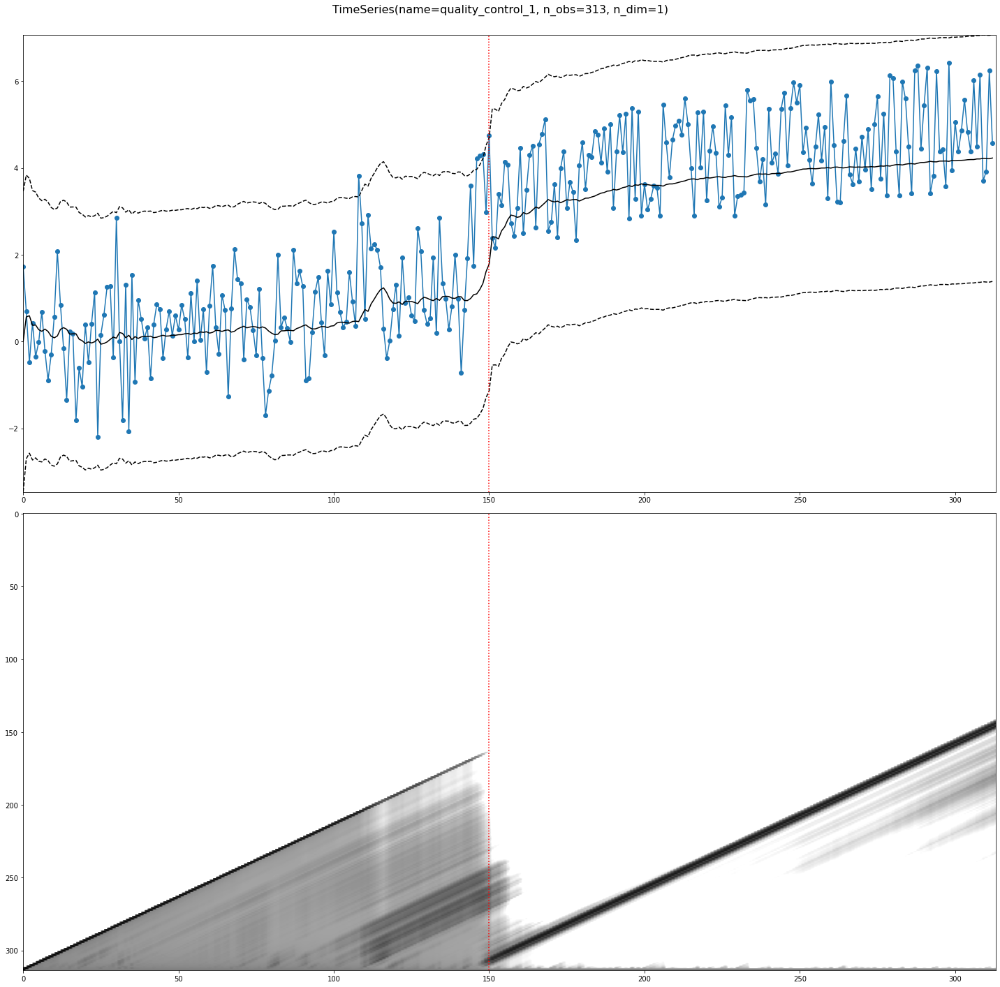

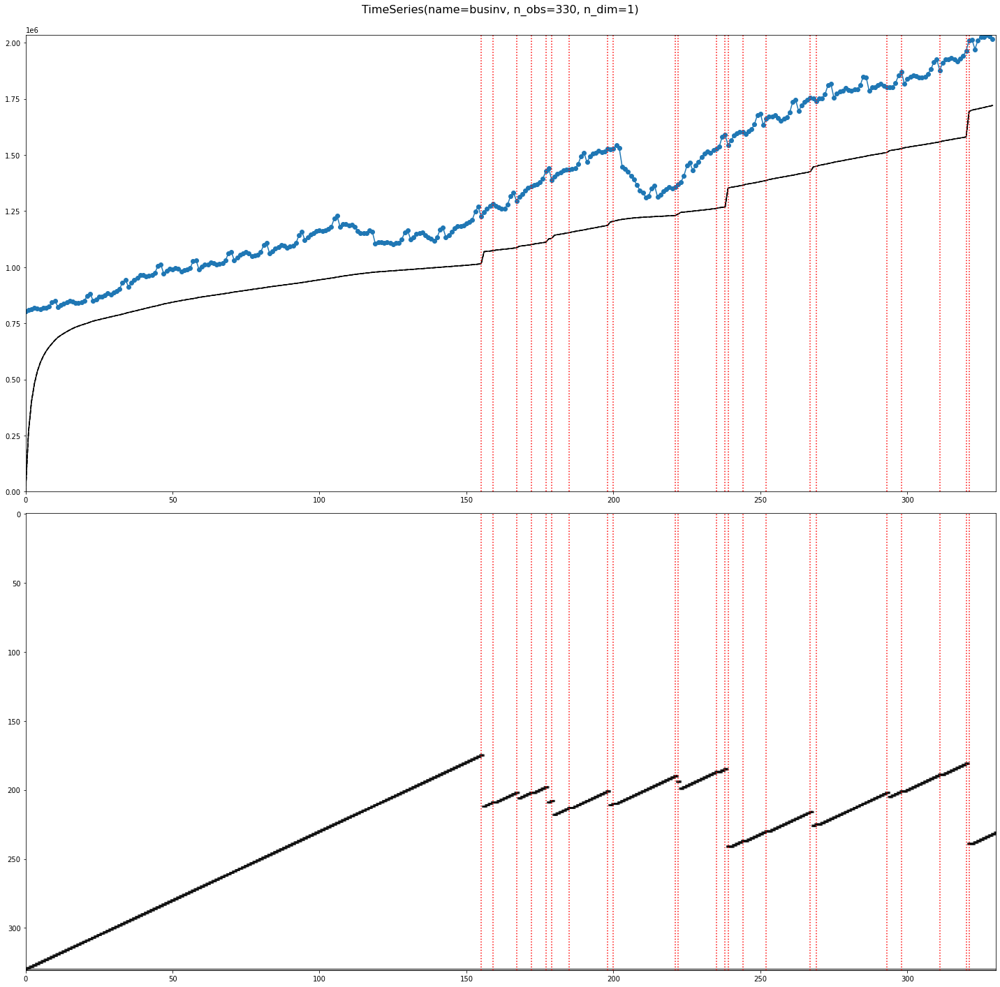

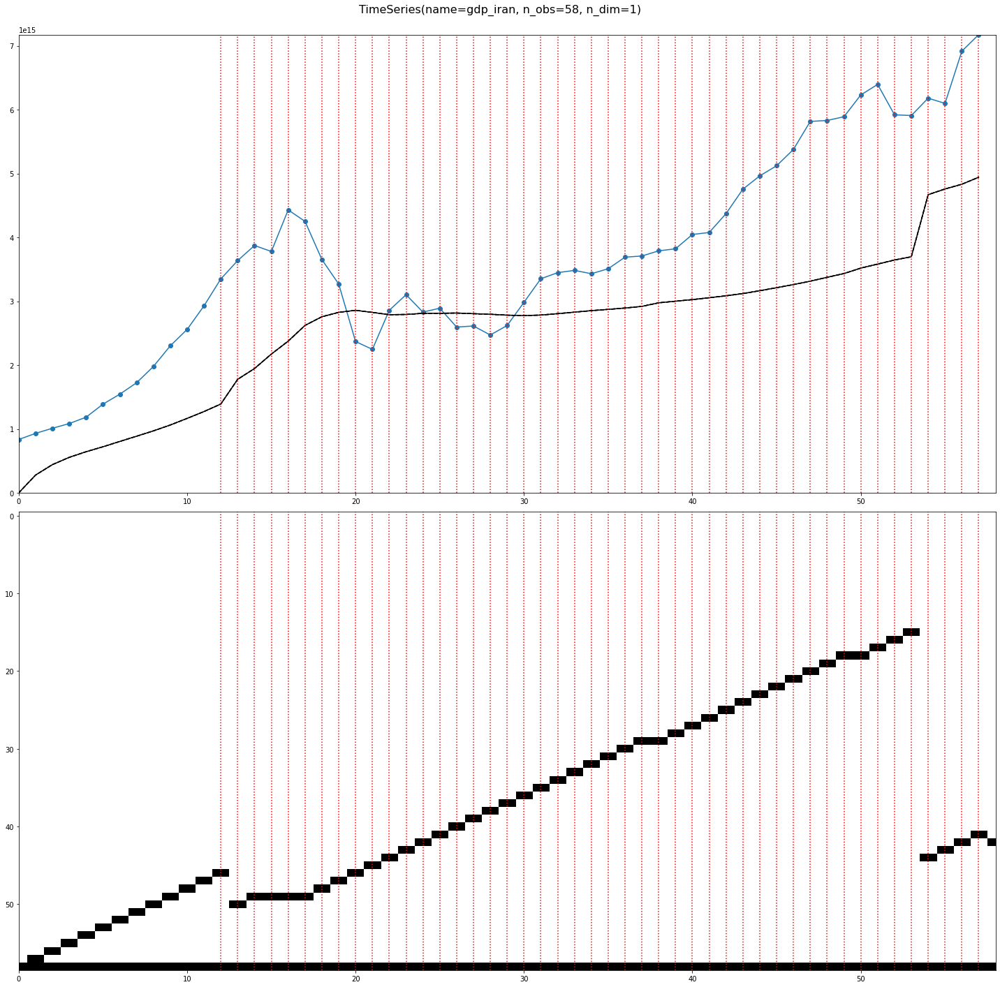

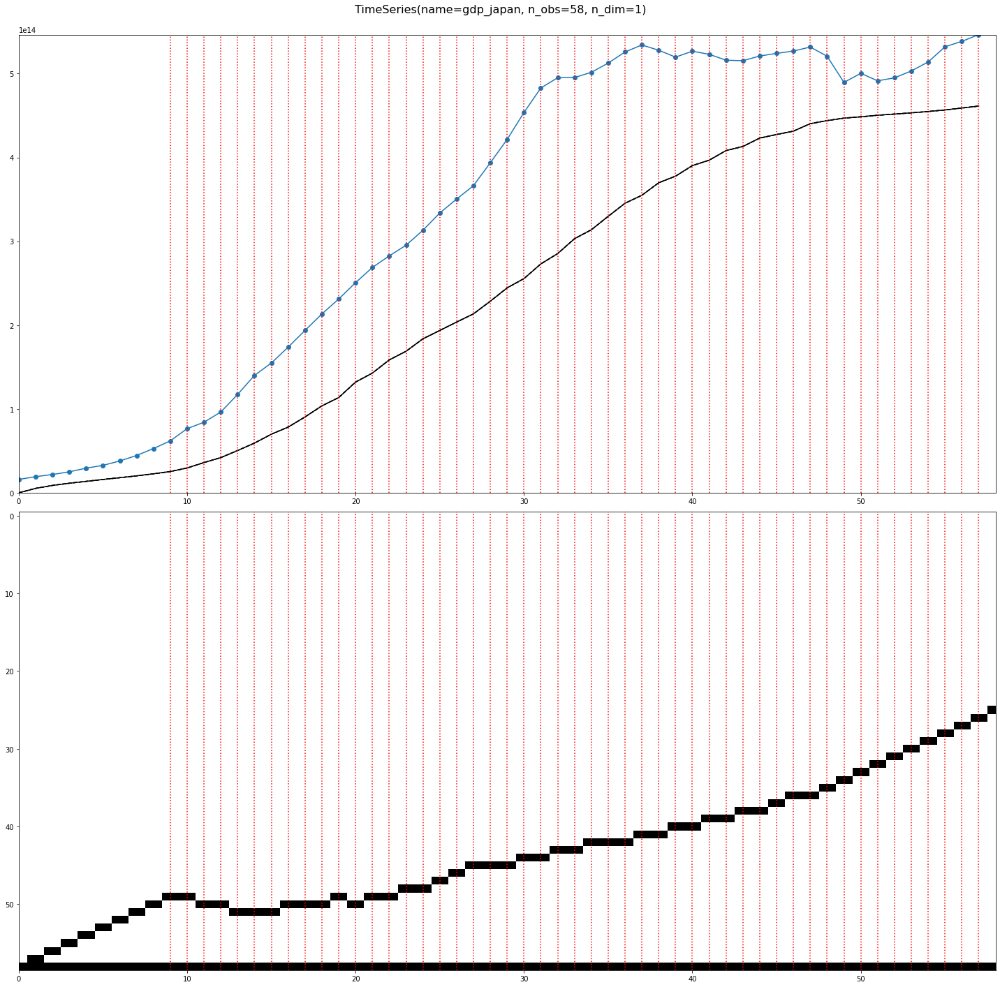

In [6]:
# Operate over files


f_measures = []
cms = []
for dfile in tqdm(data_files):
    # dfile = data_files[0]
    ts = TimeSeries.from_json(dfile)
    n_dim = ts.y.shape[1]
    annots = annot_finder(dfile, annots_file)
    fig, axes = plt.subplots(2,n_dim, figsize=(20,20))
    fig.suptitle(ts, fontsize=16)
    for i in range(n_dim):
        vals = ts.y[:,i]
        n_obs = len(vals)
        cpd = bocpd("auto")
        R, pmean, pvar = cpd.fit(vals, 100, animation=False)
        cps = _get_cps_from_R(R)
        f = EVM.f_measure(annots, cps)
        cm = EVM.covering(annots, cps, n_obs)
        f_measures.extend([f])
        cms.extend([cm])
        print(f"\n{ts.name} -----> f1 = {f}, covering = {cm} \n  ---------- TOTAL: f1_mean = {np.mean(f_measures)}, covering_mean = {np.mean(cms)}")
        if n_dim != 1:
            plot_matplotlib(axes[:,i], vals, R, pmean, pvar, cps)
        else:
            plot_matplotlib(axes, vals, R, pmean, pvar, cps)
    fig.subplots_adjust(top=.95)
    try:
        plt.savefig(f'results_bocpd/{ts.name}.jpg', optimize=True)
    except FileNotFoundError:
        !mkdir results_bocpd
        plt.savefig(f'results_bocpd/{ts.name}.jpg', optimize=True)

In [ ]:
import roerich
import numpy as np

f_measures = []
cms = []
for dfile in tqdm(data_files):
    ts = TimeSeries.from_json(dfile)
    annots = annot_finder(dfile, annots_file)

    n_dim = ts.y.shape[1]
    for i in range(n_dim):
        vals = ts.y[:,i].flatten()
        n_obs = len(vals)
        T = ts.t
        cpd = roerich.OnlineNNRuLSIF(net='default', scaler="default", 
                  metric="KL_sym", # KL_sym, KL, JSD, PE, PE_sym, Wasserstein
                  periods=2, # A number of previous data-points used when constructing autoregressive matrix
                  window_size=200, # A size of a window when splitting input data into train and test arrays
                  lag_size= 500, # A distance between train- and test- windows
                  step=20, # Each `step`-th data-point is used when creating the input dataset
                  n_epochs=8, # A number of epochs during training NN
                  lr=0.0005, # A learning rate at each step of optimizer
                  lam=0.01, # A regularization rate
                  optimizer="ASGD", # One of Adam, SGD, RMSprop or ASGD optimizers, 
                  debug = 0, # default zero
                  alpha=1
                 )
        
        try:
            score, peaks = cpd.predict(vals)
            f = EVM.f_measure(annots, peaks)
            cm = EVM.covering(annots, peaks, n_obs)
            f_measures.extend([f])
            cms.extend([cm])
            print(f"\n{ts.name} -----> f1 = {f}, covering = {cm} \n  ---------- TOTAL: f1_mean = {np.mean(f_measures)}, covering_mean = {np.mean(cms)}")
        except ValueError:
            peaks=[]
            f = EVM.f_measure(annots, peaks)
            cm = EVM.covering(annots, peaks, n_obs)
            f_measures.extend([f])
            cms.extend([cm])
            print(f"\n{ts.name} -----> f1 = {f}, covering = {cm} \n  ---------- TOTAL: f1_mean = {np.mean(f_measures)}, covering_mean = {np.mean(cms)}")
            continue
        vals = vals.reshape(-1,1)
        roerich.display(vals, T, annots, score, T, peaks)
        try:
            plt.savefig(f'results_rulsif/{ts.name}_dim_{i}.jpg', optimize=True)
        except FileNotFoundError:
            !mkdir results_rulsif
            plt.savefig(f'results_rulsif/{ts.name}.jpg', optimize=True)

from parameter_search import parameter_search_rulsif

search_space = {
    "net": "default",
    "scaler": "default",
    "metric": ["KL_sym", "KL", "JSD"],
    "periods": [1, 5, 10, 100],
    "window_size": [10, 100, 250],
    "lag_size": [100, 500, 1000],
    "step": [20],
    "n_epochs": [8],
    "lr": [0.0005],
    "lam": [0.01],
    "optimizer": ["Adam"],
    "alpha": [1],
}

dfile = data_files[0]
ts = TimeSeries.from_json(dfile)
annots = annot_finder(dfile, annots_file)
vals = ts.y[:,0].flatten()
parameter_search_rulsif(search_space, vals, eval_metric=EVM.f_measure, annotations=annots)